# Анализ сообществ в социальной сети вконтакте с применением графов

### Резюме
В этой статье мы будем анализировать участников **оффициальной группы вконтакте КАИ** https://vk.com/kaiknitu с применением теории графов. Для анализа взяты участники сообщества с открытыми профилями.


### Структура
- [общие характеристики сообщества](#Общие-характеристики-сообщества)
- [распределение признаков](#Распределение-признаков)
- [топ групп](#Топ-групп)
- [выделение популярных участников](#Выделение-популярных-участников)
- [выделение подгрупп](#Выделение-подгрупп)
    - [распределение признаков](#Распределение-признаков-sub)
    - [топ групп](#Топ-групп-sub)
- [Bonus: Боты](#Bonus:-Боты)
- [Послесловие](#Послесловие)
    - Скрипт сбора данных
    - Что можно сделать еще

## Настройка среды

In [1]:
import pandas as pd
import networkx as nx
import numpy as np
import matplotlib.pyplot as plt
from random import randint
import seaborn as sns
from graph_builder import *
import gc
import plotly.express as px
import pygwalker as pyg
from dataprep.eda import create_report, plot_diff, plot

import warnings
warnings.filterwarnings("ignore")

import plotly.io as pio
pio.renderers.default = 'iframe'
# mpl.rcParams['figure.dpi'] = 128

In [2]:
event_id = "kaiknitu"
date = '2023-09-26'
load_likes=True


data_folder = '../../data/vk-graph'
sure_members_path = f'{data_folder}/{event_id}/{date}/sure_members.json'
unsure_members_path = f'{data_folder}/{event_id}/{date}/unsure_members.json'
group_info_path= f'{data_folder}/{event_id}/{date}/group_info.json'
friends_path = f'{data_folder}/{event_id}/{date}/friends.jsonl'
followers_path = f'{data_folder}/{event_id}/{date}/followes.jsonl'
subscriptions_people_path = f'{data_folder}/{event_id}/{date}/sub_people.jsonl'
subscriptions_groups_path = f'{data_folder}/{event_id}/{date}/sub_groups.jsonl'
posts_path = f'{data_folder}/{event_id}/{date}/posts.jsonl'
likes_path = f'{data_folder}/{event_id}/{date}/likes.jsonl'
group_posts_path = f'{data_folder}/{event_id}/{date}/group_posts.jsonl'
group_likes_path = f'{data_folder}/{event_id}/{date}/group_likes.jsonl'
top_gropus_path = f'{data_folder}/{event_id}/{date}/top_groups.jsonl'


friend_sub_path = f"{data_folder}/{event_id}/{date}/friend_people_graph.gml"

In [3]:
# %%time
G = get_people_graph(event_id, date, only_members=True, load_likes=load_likes)

# take only community members with open profile
# G = nx.subgraph(G, [i for i in G.nodes if G.nodes[i].get('attr_dict')])
G = nx.subgraph(G, [i for i in G.nodes if not G.nodes[i].get('attr_dict').get('is_closed')])

In [4]:
df = get_members_df(event_id, date, load_likes=load_likes)
df = df[~df.is_closed]
df = df.drop(columns=['is_org', 'is_closed', 'node_type'])

gc.collect();
# nx.write_gml(G, friend_sub_path)

<a name="Общие-характеристики-сообщества"></a>
## Общие характеристики сообщества

Представим сообщество вконтакте в виде точек и стрелочек между ними, где точка — это человек, а стрелочка — это подписка. Если два человека дружат, то это двусторонняя стрелочка.

In [5]:
print(f'Количество открытых профилей сообщества: {G.number_of_nodes()}', 
      f'Общее количество связей между участниками: {G.number_of_edges()}', 
      f'Среднее количество друзей внутри сообщества: {np.mean([d for _, d in G.out_degree()])}',
      f'Медианное количество друзей внутри сообщества: {np.median([d for _, d in G.out_degree()])}', sep='\n')

Количество открытых профилей сообщества: 20420
Общее количество связей между участниками: 266151
Среднее количество друзей внутри сообщества: 13.033839373163564
Медианное количество друзей внутри сообщества: 4.0


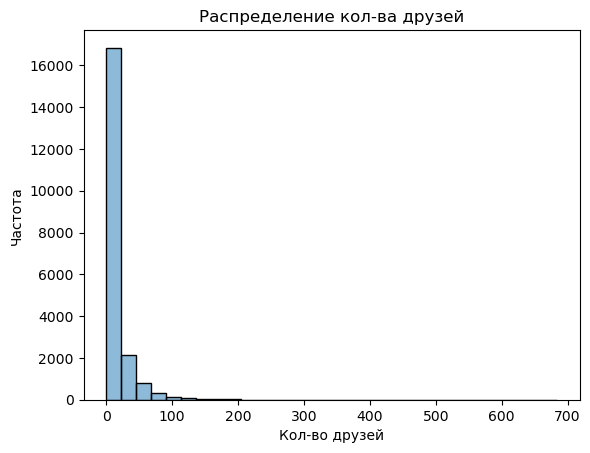

In [6]:
# Degree distribution
sns.histplot(data=dict(G.out_degree()).values(), 
             bins=30, 
             legend=False).set(
                            title='Распределение кол-ва друзей', 
                            xlabel='Кол-во друзей',
                            ylabel='Частота');

Компоненты связности - это группы пользователей, которые связаны внутри, но не связаны между собой.

In [7]:
print('Распределение размеров компонент cсвязности:')
co = pd.Series([len(i) for i in nx.weakly_connected_components(G)]).value_counts().sort_index().to_frame(name='количество таких компонент')\
    .rename_axis(index='Кол-во учатников внутри компоненты')
co

Распределение размеров компонент cсвязности:


,количество таких компонент
Кол-во учатников внутри компоненты,
1,5526
2,105
3,10
4,5
5,3
6,1
7,1
12,1
15,1


In [8]:
print(f'''Видим, что людей без друзей внутри сообщества {co.iloc[0, 0]}
Самая большая компонента включает {co.index[-1]} участников''')

Видим, что людей без друзей внутри сообщества 5526
Самая большая компонента включает 14507 участников


<a name="распределение-признаков"></a>
## Распределение признаков

city - город  
sex - пол  
byear - год рождения  
occupation - занятость  
occupation_type - тип занятости  
relation - отношения  
alcohol - отношение к алкоголю 1(резко негативное)-5(резко положительное)  
inspired_by - вдохновлен  
langs - языки  
life_main - главное в жизни  
people_main - главное в людях  
political - полит. взгляды  
religion - религия  
smoking - отношение к курению 1(резко негативное)-5(резко положительное)  
followers_count - количество подписчиков  
first_name - имя  
last_name - фамилия  
status - статус  
main_group_likes - кол-во поставленных лайков в основной группе  
got_likes_from_members - кол-во лайков, полученных от участников основной группы  
got_likes - общее кол-во полученных лайков  

  0%|                                                                                         | 0/2416 [00:00<…

DataPrep Report
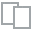
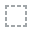
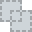
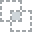
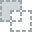
...
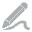
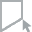
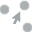
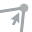
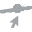

In [9]:
create_report(df)

<a name="Топ групп"></a>
### Топ групп

Группы, на которые подписаны наибольшее количество пользователей

In [10]:
with open(subscriptions_groups_path) as f:
    sub_groups = {}
    for line in f:
        sub_groups.update(json.loads(line))
with open(top_gropus_path) as f:
    top_groups = [json.loads(line) for line in f]
    top_groups = pd.DataFrame(top_groups).set_index('id')


def get_top_groups(user_ids):
    groups = []
    for user in user_ids:
        groups += [top_groups.loc[i, 'name'] if i in top_groups.index else i for i in sub_groups.get(str(user), [])]
    return pd.Series(groups).value_counts()

all_top_group = get_top_groups(df.index)
all_top_group[:30].to_frame(name="кол-во подписанных участников").rename_axis(index='Название группы')

,кол-во подписанных участников
Название группы,
КНИТУ-КАИ им. А.Н.Туполева,18229
Казань | Казань. Куда пойти?,5554
ВКазани Поймут | Казань,4547
MDK,3424
KANст,3117
Наука и Техника,3098
Интересная Казань,2808
Леонардо Дайвинчик,2752
Сарказм,2701


<a name="Выделение-популярных-участников"></a>
## Выделение популярных участников

Выведем список самых популярных людей внутри сообщества на основе eigenvector_centrality:

In [11]:
# %%time
eigenvector_centrality = nx.centrality.eigenvector_centrality(G)  # save results in a variable to use again

In [12]:
top_cen = pd.DataFrame([(df.loc[i, ['first_name', 'occupation', 'followers_count',]], j)[0] \
 for i, j in sorted(eigenvector_centrality.items(), key=lambda item: item[1], reverse=True)[:30] if i in df.index]).reset_index(drop=True)
top_cen['first_name'] = top_cen['first_name'].map(lambda x: f'{x[0]}.' if x else x)
top_cen

,first_name,occupation,followers_count
0,T.,КНИТУ-КАИ им. А. Н. Туполева,786.0
1,I.,Контур-КАИ,3570.0
2,Y.,КНИТУ-КАИ им. А. Н. Туполева,947.0
3,M.,КНИТУ-КАИ им. А. Н. Туполева,449.0
4,R.,Студенческий совет ИКТЗИ КНИТУ-КАИ,694.0
5,N.,КНИТУ-КАИ им. А. Н. Туполева,755.0
6,M.,RAP.TJ,481.0
7,R.,КНИТУ-КАИ им. А. Н. Туполева,711.0
8,Y.,КНИТУ-КАИ им. А. Н. Туполева,608.0
9,E.,КНИТУ-КАИ (бывш. КГТУ-КАИ) им. А. Н. Туполева,1913.0


<a name="Выделение-подгрупп"></a>
## Выделение подгрупп

Для выделения подгрупп возьмём самую большую компоненту. С помощью магии выделяем подгруппы, в которых связь между людьми сильнее по сравнению с остальными людьми.

Плотность графа - количество связей/ количество связей если все со всеми дружат.  
Например, если все дружат со всеми, то плотность=1, если никто ни с кем не дружит, плотность=0

Выведем список самых больших подгрупп:

In [13]:
# take biggest component
components = [(i, len(i)) for i in nx.weakly_connected_components(G)]
g = nx.subgraph(G, max(components, key=lambda x: x[1])[0])
comm = sorted(nx.community.louvain_communities(g, seed=42), key= lambda x: len(x), reverse=True)
gc.collect()

df['subgroup'] = df.index.map(lambda x: [i for i, st in enumerate(comm) if x in st])
df['subgroup'] = df['subgroup'].map(lambda x: int(x[0]) if x else np.nan)
df['subgroup']

for index, row in df.iterrows():
    if index in g.nodes:
        g.nodes[index]['subgroup'] = row['subgroup']
# nx.write_gml(g, friend_sub_path)

comm_df = pd.DataFrame({'sett': comm})
comm_df['размер'] = comm_df.sett.map(len)
comm_df['медианное кол-во друзей'] = comm_df.sett.map(lambda x: np.median([d for _, d in nx.subgraph(g, x).out_degree()]))
comm_df['плотность'] = comm_df.sett.map(lambda x: nx.density(nx.subgraph(g, x)))

n_top = 10
comm_df.head(n_top)

,sett,размер,медианное кол-во друзей,плотность
0,"{18792448, 58810371, 68853764, 5439493, 281395...",2738,7.0,0.004865
1,"{105115654, 456241159, 370040840, 397312016, 3...",1364,15.0,0.015503
2,"{166821899, 342474763, 194035728, 225013779, 2...",1177,16.0,0.019824
3,"{305678337, 331235332, 252526596, 66318342, 19...",771,12.0,0.022526
4,"{44539904, 458391553, 322768896, 7036929, 1136...",762,3.0,0.009671
5,"{181161984, 559691786, 496506892, 190709776, 2...",740,10.0,0.022914
6,"{47558658, 40460297, 85794826, 97140747, 19686...",669,6.0,0.014124
7,"{138432523, 694749198, 185620499, 93790232, 12...",657,14.0,0.029534
8,"{50675724, 129102865, 67885073, 194024467, 103...",383,10.0,0.035768
9,"{213336064, 653652994, 315289604, 475541509, 1...",333,13.0,0.054959


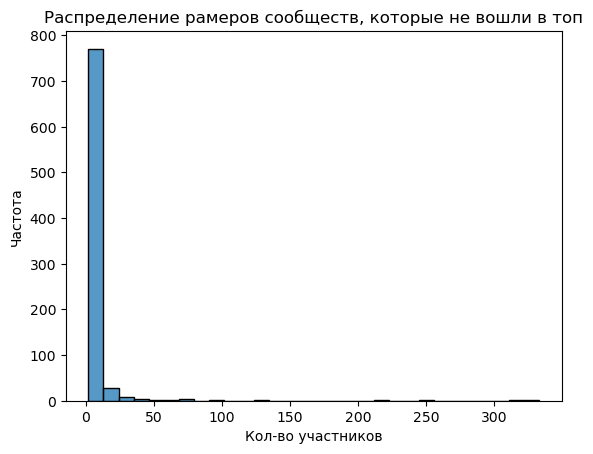

In [14]:
sns.histplot(data=comm_df[(comm_df['размер'] <= comm_df.iloc[n_top-1]['размер']) & (comm_df['размер'] > 1)]['размер'], 
             bins=30, 
             legend=False).set(
                            title='Распределение рамеров сообществ, которые не вошли в топ', 
                            xlabel='Кол-во участников',
                            ylabel='Частота');


<a name="Распределение-признаков-sub"></a>
## Распределение признаков

Сравним 5 самых больших подгрупп


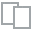
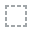
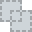
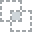
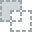
...
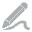
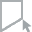
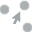
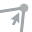
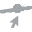

In [15]:
plot_diff([df[df['subgroup'] == i] for i in range(0, 5)], config={"diff.label": [f'{i}_subgroup' for i in range(0, 5)]})

- Видим, что в нулевой подгруппе много стариков примерно 85-90 года рождения.  
- В четвертой подгруппе много работяг, столько же сколько и учащихся. Также в этой подгруппе, больше женщин, в остальных наоборот. Медиана примерно 1985 года рождения.

<a name="Топ-групп-sub"></a>
## Топ подписок

Теперь посмотрим топ подписок в разных подгруппах

In [16]:
st = 0
end = 5
group_view = [i for i in range(st, end)]
topg = [set(get_top_groups(comm[i]).index[:50]) for i in group_view]
common_topg = set(topg[0])
for i in topg:
    common_topg.intersection_update(i)
print('Общих групп:', len(common_topg), '\nОбщие группы:', common_topg)
m = pd.concat([pd.Series([i for i in get_top_groups(comm[i]).index[:50] if (i not in common_topg)]) for i in group_view], axis=1).rename_axis(index='Топ групп\Номер подгруппы').set_axis(group_view, axis=1)
# pd.concat([pd.Series([i for i in get_top_groups(comm[i]).index[:50] if (i not in all_top_group[:20]) and (i not in common_topg)]) for i in range(1,5)], axis=1).rename_axis(index='Топ групп\Номер подгруппы')
m

Общих групп: 10 
Общие группы: {'Наука и Техника', 'КНИТУ-КАИ им. А.Н.Туполева', 'ВКазани Поймут | Казань', 'Сарказм', 'MDK', 'Регион-116 | Казань', 'Новинки Музыки | Новая Музыка 2023', 'Казань | Казань. Куда пойти?', 'Казань | Татарстан | 116', 'Интересная Казань'}


,0,1,2,3,4
Топ групп\Номер подгруппы,,,,,
0,Казань Онлайн | Главный Казанский Паблик,KANст,"Дирекция института КТЗИ, КНИТУ-КАИ, 7 здание",КНИТУ-КАИ (КГТУ им. А.Н. Туполева). ИРЭФ-ЦТ,Бесплатная Казань
1,КАЗАНЬ | Социальная группа,Студенческий спортивный клуб «КАИ-Зилант»,Студенческий совет ИКТЗИ КНИТУ-КАИ,ИРЭТ (ИРЭФ-ЦТ),Казань Онлайн | Главный Казанский Паблик
2,Новости про Казань | Татарстан,Бот расписание занятий. КНИТУ-КАИ,KANст,KANст,Психология
3,Бесплатная Казань,Мемфабрика,Бот расписание занятий. КНИТУ-КАИ,Бот расписание занятий. КНИТУ-КАИ,Работа в Казани
4,Science|Наука,Леонардо Дайвинчик,Студенческий спортивный клуб «КАИ-Зилант»,Студенческий спортивный клуб «КАИ-Зилант»,КАЗАНЬ | Социальная группа
5,Идеи дизайна интерьера,Рифмы и Панчи,Мемуары ценителей научных мемов,Леонардо Дайвинчик,Новости про Казань | Татарстан
6,Психология,Мемуары ценителей научных мемов,Reddit,Рифмы и Панчи,Республика Татарстан
7,Палата №6,4ch,Леонардо Дайвинчик,4ch,Барахолка Казань
8,Киномания - Лучшие фильмы,ПОЗОР,Рифмы и Панчи,ПОЗОР,Город Казань


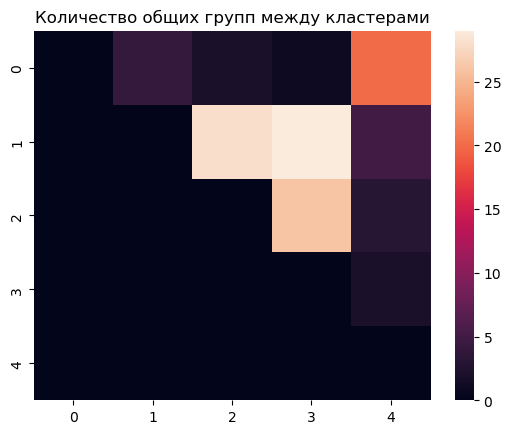

In [17]:
cf = [[0 for i in range(st, end)] for j in range(st, end)]
for i in range(st, end-1):
    for j in range(i+1, end):
        cf[i][j] = len(set(m.loc[:, i]).intersection(set(m.loc[:, j])))

sns.heatmap(np.array(cf))
plt.title('Количество общих групп между кластерами');

Легко заметить, что сообществ, которых нет в нулевой и четвертой подгруппе, часто встречаются в оставшихся.  
Уберем из сравнения нулевую и четвертую подгруппу.

In [18]:
# подгруппы для сравнения
group_view = [1, 2, 3]
topg = [set(get_top_groups(comm[i]).index[:50]) for i in group_view]
common_topg = set(topg[0])
for i in topg:
    common_topg.intersection_update(i)
print('Общих групп:', len(common_topg), '\nОбщие группы:', common_topg)
pd.concat([pd.Series([i for i in get_top_groups(comm[i]).index[:50] if (i not in common_topg)]) for i in group_view], axis=1).rename_axis(index='Топ групп\Номер подгруппы').set_axis(group_view, axis=1)

Общих групп: 33 
Общие группы: {'Смейся до слёз :D', 'ВКонтакте', 'ПОЗОР', 'Студенческий спортивный клуб «КАИ-Зилант»', 'На Случай Важных Переговоров', 'Мемуары ценителей научных мемов', 'Леонардо Дайвинчик', 'Лайфхак', 'КБ', 'Словарный запас', 'IGM', 'КНИТУ-КАИ им. А.Н.Туполева', 'Додо Пицца Казань', 'Новинки Музыки | Новая Музыка 2023', 'Казань | Казань. Куда пойти?', 'Татарлары | Татарлар | Татары', 'Сарказм', 'Netflix', 'Овсянка, сэр!', 'Палата №6', 'Рифмы и Панчи', 'Reddit', 'Интересная Казань', 'Наука и Техника', 'MARVEL/DC', 'ВКазани Поймут | Казань', 'KANст', 'MDK', 'Регион-116 | Казань', 'Бот расписание занятий. КНИТУ-КАИ', 'Казань | Татарстан | 116', 'NR', '4ch'}


,1,2,3
Топ групп\Номер подгруппы,,,
0,Мемфабрика,"Дирекция института КТЗИ, КНИТУ-КАИ, 7 здание",КНИТУ-КАИ (КГТУ им. А.Н. Туполева). ИРЭФ-ЦТ
1,Цитаты преподавателей КАИ,Студенческий совет ИКТЗИ КНИТУ-КАИ,ИРЭТ (ИРЭФ-ЦТ)
2,Бот Максим,Цитаты преподавателей КАИ,"Копицентр ""КопиКонь"""
3,Хитрости жизни,Словарный запас (EN),Аниме
4,Словарный запас (EN),WebM 2.0,НЕНОРМАЛЬНО
5,НЕНОРМАЛЬНО,ачё),WebM 2.0
6,Я тебя хочу,На приеме у Шевцова,СТЫД
7,Казань| РАБОТА,Библиотека программиста,Бот Максим
8,МХК,Подслушано общага #3 КНИТУ-КАИ,Мой Компьютер


<a name="Bonus:-Боты-sub"></a>
## Bonus: Боты

Выведем одну из компонент связности и посчитаем плотность:

Плотность графа: 0.9898039215686274


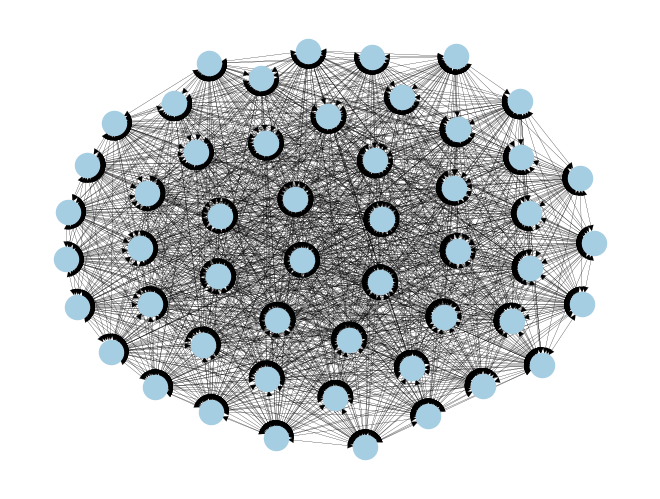

In [19]:
a = [i for i in nx.weakly_connected_components(G) if len(i) == 51]

print('Плотность графа:', nx.density(G.subgraph(a[0])))
pos = nx.spring_layout(G.subgraph(a[0]), iterations=100, seed=12, k=5)
nx.draw(G.subgraph(a[0]), pos=pos, with_labels=False, width=0.1, node_color=(0.6509803921568628, 0.807843137254902, 0.8901960784313725),)

Плотность графа близка к единице. Кажется, это очень дружная и обособленная компания, либо боты.

Давайте посмотрим на какие группы они подписаны:

In [20]:
get_top_groups(list(G.subgraph(a[0]).nodes))[:35].to_frame(name="кол-во").rename_axis(index='Название группы')

,кол-во
Название группы,
Авторынок Луганск Донецк ДНР ЛНР,92
Вкратце | Тула!,51
Наша Балашиха,51
Барахолка Рязань Объявления Куплю Продам,51
Барахолка Электросталь Ногинск Объявления,51
Наш Реутов,51
Наша Электросталь,51
ПЕВИЦА Элла Величковская,51
Новые игры,51


<a name="Послесловие"></a>
## Послесловие
### Скрипт сбора данных - 
С помощью данного скрипта можно спарсить сообщество в 25к примерно за неделю, 20к будут с открытыми профилями.
Для работы скрипта нужно ссылка на группу вк. Скрипт соберет информацию об участниках. Это может быть и сообщество, и мероприятие.  
Какие данные мы получаем:  
- основную информацию об участниках сообщества: пол, имя, город, дата рождения, университет, место работы и т.д. (здесь много пропусков, т.к. не все указывают все, но например город есть почти у всех)
- кто с кем дружит, кто на кого подписан
- подписки участников на группы, общую информацию о топ-n группах(тематика, название...)
- последние 100 постов участников, лайки на них
- последние 100 постов сообщества вк, лайки к ним

### Что можно сделать еще
- разбить тексты постов людей на кластеры и посмотреть самы популярные, самые популярные внутри сообщества(инструменты: carrot2, rubert + sklearn)
- найти тональность постов(положительная, нейтральная, негативная), посмотреть аггрегированную тональность кластеров текстов, сравнить все это между несколькими подгруппами людей
- выбрать другой алгоритм разбиения участников на подгруппы, который сможет учитвать не только связи между участниками, но и другими характеристиками(node2vec + sklearn), или просто другой алгоритм(в посте испольлзуется louvain, можно применить Leiden, Walktrap и еще десятки из библиотеки cdlib)
- сделать предсказание ребер на основе общих друзей например, 2 учаснтика сообщества не дружат между собой, но у них 30 общих друзей, можно посчитать вероятность того, что они дружат и положить это значение в вес ребра
- сделать граф, основанный на лайках, а не дружбе. Может даже совместить, еще и вк группы засунуть, но интерпретировать будет сложнее.
- собрать информацию о группах не по подпискам а по лайкам, но это займет времени в десятки раз больше, вероятно